# Chapter 6: Dictionary and Set


6. 5 ***(Counting Votes)*** Write a script that uses a dictionary to determine the number of votes received by candidates in an election. The votes are concatenated in a string where each vote is separated from the next by a comma.

In [4]:
import pandas as pd
from collections import Counter

data = pd.read_csv("president_county_candidate.csv") #US 2020 election

candidates = data.filter(["candidate"]).head(10_000).to_dict("records")
names = list()

list(names.append(*i.values()) for i in candidates) #filters only candidate names

print(f"{'Candidate':<13} {'Votes':>16} {'%':>11}")

for name,votes in Counter(names).items():
   
    print(f"{name.lstrip():20} {votes:9} {(votes/ len(names)) * 100 :13.2f}")

Candidate                Votes           %
Joe Biden                 1655         16.55
Donald Trump              1656         16.56
Jo Jorgensen              1655         16.55
Howie Hawkins             1071         10.71
Write-ins                 1459         14.59
Gloria La Riva             242          2.42
Brock Pierce               339          3.39
Rocky De La Fuente         708          7.08
Don Blankenship            278          2.78
Kanye West                 327          3.27
Brian Carroll              167          1.67
Ricki Sue King              99          0.99
Jade Simmons                64          0.64
President Boddie            64          0.64
Bill Hammons                64          0.64
Tom Hoefling                64          0.64
Alyson Kennedy              64          0.64
Jerome Segal                24          0.24


6. 6 ***(Duplicate Email Address Removal)*** Write a function that receives a list of email addresses and displays only the unique addresses. Treat uppercase and lowercase letters the same. The function should use a set to get the unique email addresses from the list. Test your function with several different lists. 

In [5]:
def removeDuplicate(emails:list)  -> print :
    """Remove duplicare emails and displays unique addresses """
    from pandas import DataFrame
    from itertools import chain
    from numpy import unique
    
    emails_cleaner = set(map(lambda x: x.lower(),   #merges all addresses into a single list,
                             chain.from_iterable(emails.values())))  #transforms them all with lower case letters and removes duplicates using a set
   
    frequencies= unique(list(chain.from_iterable(emails.values())), return_counts=True)[1] #gets the number of emails received per account
    return DataFrame(zip(emails_cleaner,frequencies), columns= ["Email Addresses","Received"]).sort_values(by="Received",  ascending=False)

df = pd.read_csv("email-links-all.csv") #Enron datasets

emails = df.filter(["From","To"]).to_dict("list") #gets only email addresses

removeDuplicate(emails)

,Email Addresses,Received
12920,pereira,24553
15138,laoh@chevron.com,24245
25515,raicher@kmz.com,19824
20881,thierry.noel@enron.com,18341
26981,deborah.arango@enron.com,17431
...,...,...
19676,report@gradfinder.com,1
19677,jim_barnes@pgn.com,1
7627,shirley.tijerina@enron.com,1
7625,arquella.hargrove@enron.com,1


6. 7 ***(Character Frequency Analysis)*** In cryptoanalysis, the technique of character frequency analysis is often used to decipher a message when the key is unknown. This technique calculates the frequency of each character in the encrypted text and maps this to the frequency of characters used in, for instance, the English language. Write a script that uses a dictionary to summarize the frequency of each word in a given text. Ignore case, ignore spaces and assume that the user does not enter any punctuation. Display a two-column table of the words and their frequency. 

In [6]:
import pandas as pd
from nltk.corpus import stopwords
from collections import Counter

data = pd.read_table("shakespeare.txt") #Shakespeare texts
df = data.to_markdown().split() 

stopwords = stopwords.words("english") 

string_cleaner = Counter((filter(lambda x: x.isalpha() and x not in (stopwords),
                                 map(lambda i: i.lower() ,df))))

print(f"{'Words':10}{'Frequency'}")
for word, count in  string_cleaner.most_common(10):
    print(f"{word:10} {(count/ len(string_cleaner.values())) * 100 :6.2f} %")

Words     Frequency
thou        28.02 %
thy         21.97 %
shall       18.95 %
good        13.96 %
would       12.22 %
let         11.39 %
enter       10.98 %
hath        10.37 %
thee         9.79 %
may          9.61 %


6. 8 ***(Challenge: Writing the Word Equivalent of a Check Amount)*** In check-writing systems, it's crucial to prevent alteration of check amounts. One common security method requires that the amount be written in numbers and spelled out in words as well. Even if someone can alter the numerical amount of the check, it's tough to change the amount in words. Create a dictionary that maps numbers to their corresponding word equivalents. Write a script that inputs a numeric check amount that's less than 1000 and uses the dictionary to write the word equivalent of the amount. For example, the amount 112.43 should be written as   "*ONE HUNDRED TWELVE AND 43/100*" .

In [5]:

def numbers_to_words(number:int or float) -> str:
    """
        Convert a number to a English word representation.
    """
    
    def number_decomposer(n: int | float, key= None) -> list:
        """
            n > 0 \\
            decomposition of the number into its relative values. \\
            return a list in the order: millions, thousands, hundreds, ones and decimal part.\\
            key --> place value  e.g. "decimal" or list/tuple of positional values e.g. ["tens", "ones", "millions",...]
        """

        units = n
        tens = hundreds = thousands = millions = int()
        
        while units >= 10:
            if units >= 1_000_000:
                millions = units // 1_000_000
                units -= millions * 1_000_000
            
            if units >= 1_000:
                thousands = units // 1_000
                units -=  thousands * 1_000
            
            if units >= 100:
                hundreds = units // 100
                units -= hundreds * 100

            if units >= 10 :
                tens = units // 10
                units -=  tens * 10
        
        place_values = [ int(millions), int(thousands ), int(hundreds ), 
                        int(tens ), int(units), round(units - int(units),3)] 
        
        match key :
            case list() | tuple() | str() as key:
                place_values = {"decimal": place_values[5], "ones": place_values[4] , "tens": place_values[3], 
                                "hundreds": place_values[2], "thousands": place_values[1], "millions": place_values[0]}
                
                return list(map(lambda x : place_values.get(x), key)) if isinstance(key,(list,tuple)) else place_values.get(key)
            
            case _:
                return place_values
        
    
    millions, thousands, hundreds, tens, units, fractional_part = number_decomposer(number) 
    numbers = {
            1: "ONE", 2: "TWO", 3: "THREE", 4: "FOUR", 5: "FIVE" , 6: "SIX", 7: "SEVEN", 8: "EIGHT", 9: "NINE", 10: "TEN",
            11: "ELEVEN", 12: "TWELVE", 13: "THIRTEEN", 14: "FOURTEEN", 15: "FIFTEEN", 16: "SIXTEEN", 17: "SEVENTEEN", 18: "EIGHTEEN",
            19: "NINETEEN", 20: "TWENTY", 30: "THIRTY", 40: "FORTY", 50: "FIFTY", 60: "SIXTY", 70: "SEVENTY", 80: "EIGHTY", 90: "NINETY", 
            100: "HUNDRED", 1_000: "THOUSAND", 1_000_000 : "MILLION"
            }
    word =  str()
    
    if  millions:  #constructs the positional values of the periods of MILLIONS
        
        hundred_millions , ten_millions, unit_millions = number_decomposer(millions, key=["hundreds", "tens", "ones"])
        
        if numbers.get(hundred_millions): # e.g. 9xx_xxx_xxx == NINE HUNDRED...
            word += numbers.get(hundred_millions) + " " + numbers.get(100) +" "
        
        if not any([ten_millions, unit_millions]): # if both are 0 only the word "MILLION" is added to the string, e.g. 400_xxx_xxx == FOUR HUNDRED MILLION...
            word += numbers.get(10**6) + " "
        
        elif numbers.get(int( str(ten_millions) + str(unit_millions))) :  #if the concatenation of the periods ten_million and unit_million is in the dictionary are added to the string                                                                
            word +=  numbers.get(int( str(ten_millions) + str(unit_millions)) ) +" "+ numbers.get(10**6) +" "  #e.g. int("1" + "4") = FOURTEEN or  int("05") = FIVE....MILLION
        else :
            word += numbers.get(ten_millions * 10)+ "-" + numbers.get(unit_millions) +" "+ numbers.get(10**6) + " "  #Otherwise it is built, e.g. Forty-Five , Sixty-Six....MILLION
    
    if thousands: #constructs the positional values of the periods of THOUSANDS
         
        hundred_thousands, ten_thousands, unit_thousands = number_decomposer(thousands, key=["hundreds", "tens", "ones"])
         
        if numbers.get(hundred_thousands): #e.g 8xx_xxx == EIGHT HUNDRED...
            word += numbers.get(hundred_thousands) + " " + numbers.get(100) +" "
         
        if not any([ten_thousands, unit_thousands]): #if both are 0 only the word "THOUSAND" is added to the string, e.g. 400_xxx == FOUR HUNDRED THOUSAND...
            word += numbers.get(10**3) + " "
        
        elif numbers.get(int( str(ten_thousands) + str(unit_thousands))) : #if the concatenation of the periods ten_thousands and unit_thousands is in the dictionary are added to the string
            word +=  numbers.get(int( str(ten_thousands) + str(unit_thousands)) ) +" "+ numbers.get(10**3) + " " # e.g. int('11') = eleven or  int(str(0) + str(9))= nine....THOUSAND
        
        else :
            word += numbers.get(ten_thousands * 10)+ "-" + numbers.get(unit_thousands) +" "+ numbers.get(10**3) + " " ##Otherwise it is built, e.g. Forty-Five , Sixty-Six....THOUSAND
   
    if any([hundreds, tens, units]): # if any is non-zero, their values are constructed 
        
        if numbers.get(hundreds): # e.g. 7xx == seven hundred...
            word+= numbers.get(hundreds) +" " + numbers.get(100) + " "
        
        if tens : 
            
            if int(str(tens) + str(units)) in numbers: # #if the concatenation of the periods tens  and units is in the dictionary are added to the string
                word += numbers.get(int(str(tens) + str(units)))  #e.g int("19") = nineteen or  int(str(1) + str(2)) = twelve
            else:
                word += numbers.get(tens * 10)+ "-" + numbers.get(units) # otherwise it is built 
        
        elif units: #if tens = 0 or tens and hundred = 0 , then there is only the unit 
            word += numbers.get(units) 
                    
    if fractional_part : #if there is a decimal part, its representation is constructed
        
        fractional_part = str(fractional_part).split(".")[1] #the decimal point is deleted 
        thousandths ,hundredths, tenths = number_decomposer(int(fractional_part), key=["hundreds", "tens", "ones"])
        
        if any(number_decomposer(number)[:-1]) : #if the number has an integer part
           
            if numbers.get(thousandths) :
                word += " AND " +  numbers.get(thousandths) +" " + numbers.get(100) + " "
                
                if numbers.get(int(str(hundredths) + str(tenths)) ):
                    word += numbers.get(int(str(hundredths) + str(tenths))) + " THOUSANDTHS"
                else:
                    word += numbers.get(hundredths * 10)+ "-" + numbers.get(tenths) +  " THOUSANDTHS"
            
            elif numbers.get(hundredths):
                
                if numbers.get(int(str(hundredths) + str(tenths)) ):
                    word += " AND " + numbers.get(int(str(hundredths) + str(tenths))) + " HUNDREDTHS"
                else:
                    word += " AND " + numbers.get(hundredths * 10)+ "-" + numbers.get(tenths) +  " HUNDREDTHS"
            else :
                word += " AND " + numbers.get(tenths) + " TENTHS"
            
        else: #otherwise, only the part decimal is represented 
            
            if numbers.get(thousandths) :
                word += numbers.get(thousandths) +" " + numbers.get(100) + " "
                
                if numbers.get(int(str(hundredths) + str(tenths)) ):
                    word += numbers.get(int(str(hundredths) + str(tenths))) + " THOUSANDTHS"
                else:
                    word += numbers.get(hundredths * 10)+ "-" + numbers.get(tenths) +  " THOUSANDTHS"
            
            elif numbers.get(hundredths):
                
                if numbers.get(int(str(hundredths) + str(tenths)) ):
                    word += numbers.get(int(str(hundredths) + str(tenths))) + " HUNDREDTHS"
                else:
                    word += numbers.get(hundredths * 10)+ "-" + numbers.get(tenths) +  " HUNDREDTHS"
            else :
                word += numbers.get(tenths) + " TENTHS"
            
        
    return word


print(numbers_to_words(123), numbers_to_words(1_230_987), numbers_to_words(0.54),
      numbers_to_words(9.5), numbers_to_words(999_666_333.999), sep= "\n")

ONE HUNDRED TWENTY-THREE
ONE MILLION TWO HUNDRED THIRTY THOUSAND NINE HUNDRED EIGHTY-SEVEN
FIFTY-FOUR HUNDREDTHS
NINE AND FIVE TENTHS
NINE HUNDRED NINETY-NINE MILLION SIX HUNDRED SIXTY-SIX THOUSAND THREE HUNDRED THIRTY-THREE AND NINE HUNDRED NINETY-NINE THOUSANDTHS


6. 9 ***(Dictionary Manipulations)*** Using the following dictionary, which maps country names to abbreviations:
```py 
tlds = {'Canada': 'Ca', 'United States': 'us', 'Mexico': 'mx'}
```
Write a script that shows the user a list od dictionary manipulation options to choose from. Based on the choice, the corresponding manipulation is performed, and the result is show on the screen. The following choices can be made the user:
- a) Show the abbreviation of a country chosen by the user.
- b) Display all key-value pairs in a two-column forman.
- c) Add a new key-value pair to the dictionary or change the value of an existing key-value pair.
- d) Create a new dictionary with the values of the first dictionary as keys and the keys of the first dictionary as values.
- e) Convert all the abbreviation in the dictionary to uppercase letters.

In [ ]:
tlds = {'Canada': 'ca', 'United States': 'us', 'Mexico': 'mx'}

def options(choice : str) -> None:
    """based on the option, the corresponding manipulation is performed."""
    
    match choice :
        case 'a':
            
            country = input("Enter the Country: ").capitalize()
            print( "Abbreviation: ", tlds.get(country, "Country is not available"))
            
        case 'b':
            
            print(f"{'Countries':18}{'Abbreviations':}")
            for k,v in tlds.items():
                print(f"{k:23}{v}")
            
        case 'c':
            
            keys, value = input("Country: ").capitalize(), input("Abbreviation: ")
            tlds.update({keys : value})
            print(*(f"{key}: {value}, " for key, value in tlds.items()) )
            
        case 'd':
            
            new = {v: k for k,v in tlds.items()}
            print(*(f"{key}: {value}, " for key, value in new.items()) )
        
        case "e":
            
            tlds.update({key: value.upper() for key, value in tlds.items()})
            print(*(f"{key}: {value}, " for key, value in tlds.items()) )
        
        case _:
            print("The option entered does not match with the available options.")
            
print("Dictionary with Countries and their abbreviations")
print(*(f"{key}: {value}, " for key, value in tlds.items()))

# while  True:
#     print()
#     print("Available Options:")
#     print("""          a) Show the abbreviation of a country,
#           b) Show all countries and their abbreviations
#           c) Add a new country and its abbreviation or change the abbreviation of a country.
#           d) Create a new dictionary with the abbreviations of the first dictionary as keys and their countries as values.
#           e) Convert all the abbreviations in the dictionary to uppercase letters. 
#           f) exit.""")
    
#     print()
#     question = input("Enter a choice: ")
#     if question == "f" :
#         break
#     options(question)
#     print()

6. 10 ***(Set Manipulation)*** Write a script where two sets of colors are created. Write functions that use either the comparison operators or the mathematical set operators to display the following results:
- a) Display the set with the highest number of elements.
- b) Display whether Set 1 = Set 2.
- c) Displat the results of the | , &, -, and ^ operations.


In [6]:
def functions(set_one: set, set_two: set, choice: str)-> set | bool:
    "Returns the result of the operation"
    
    operations =  {
                   'Union' : lambda x,z : x | z, 'Intersection' : lambda x,z : x & z, 
                   'Difference' : lambda x,z : x - z, 'Symmetric Difference' : lambda x,z : x ^ z, 
                   'Equal' : lambda x,z : x == z, 'Not Equal' : lambda x,z : x != z, 
                   'Subset': lambda x,z: x < z, 'Superset': lambda x,z: x > z
                   }
    
    if choice.capitalize() in operations:
         return operations.get(choice.capitalize())(set_one, set_two)
    elif "highest":
        return set_one  if len(set_one) > len(set_two) else set_two
    else:
        print(f"{choice} does not match")   

set_one = {
            'Black', 'Yellow', 'Pink', 'Gold', 'Red', 'Turquoise', 'Olive Drab', 
            'Orchid', 'Brown', 'Orange', 'Purple', 'Golden', 'light Blue', 'Sandy Brown', 'Spring Green', 'Maroon',
            'Aquamarine', 'Dark Green', 'Violet', 'Burgundy', 'Blue','Chocolate','Cyan','Dark Blue','Dark Red','Gray',
            'Green','Ivory','Salmon','Silver','Violet Red','Wheat','White'
            }     
set_two = {
            'Gray', 'Red', 'Blue', 'Green', 'Cyan', 'Chocolate', 'Salmon', 'Ivory',
            'White', 'Dark Red', 'Dark Blue', 'Silver', 'Aquamarine', 'Dark Green', 'Violet Red', 'Wheat', 'Black',
            'Purple' 
            }
task = "highest", "equal", "union", "intersection", "difference", "symmetric difference", "superset"

print(f"Set 1: {set_one}\n")
print(f"Set 2: {set_two}\n")

for choice in task:
    print(choice)
    print(functions(set_one, set_two, choice))
    print()


Set 1: {'Sandy Brown', 'Orange', 'Dark Red', 'Gray', 'Salmon', 'Maroon', 'Yellow', 'Cyan', 'Olive Drab', 'light Blue', 'Spring Green', 'Black', 'Wheat', 'Green', 'Violet', 'Dark Green', 'Brown', 'Turquoise', 'Violet Red', 'Golden', 'Chocolate', 'Purple', 'Silver', 'Gold', 'Ivory', 'White', 'Pink', 'Red', 'Orchid', 'Burgundy', 'Blue', 'Aquamarine', 'Dark Blue'}

Set 2: {'Violet Red', 'Dark Red', 'Gray', 'Salmon', 'Chocolate', 'Purple', 'Silver', 'Cyan', 'Ivory', 'White', 'Red', 'Black', 'Wheat', 'Green', 'Blue', 'Dark Green', 'Aquamarine', 'Dark Blue'}

highest
{'Sandy Brown', 'Orange', 'Dark Red', 'Gray', 'Salmon', 'Maroon', 'Yellow', 'Cyan', 'Olive Drab', 'light Blue', 'Spring Green', 'Black', 'Wheat', 'Green', 'Violet', 'Dark Green', 'Brown', 'Turquoise', 'Violet Red', 'Golden', 'Chocolate', 'Purple', 'Silver', 'Gold', 'Ivory', 'White', 'Pink', 'Red', 'Orchid', 'Burgundy', 'Blue', 'Aquamarine', 'Dark Blue'}

equal
False

union
{'Sandy Brown', 'Orange', 'Dark Red', 'Gray', 'Salmon', '

6. 11 ***(Analyzing the Game of Craps)*** Modify the scrip of Fig. 4.2 to play 1,000,000 games of craps. Use *wins* dictionary keep track of the number of games won for a particular number of rolls. Similarly. use *losses* dictionary to keep track of the number of games lost for a particular number of rolls. As the simulation proceeds, keep updating the dictionaries.\
Display a summary of the results including:
- a) the percentage of the total games played that were won.
- b) the percentage of the total games played that were lost.
- c) the percentage of the total games played that were won or lost on given roll.
- d) the *cumulative* percentage of the total games played that were won or lost up to and including a given number of rolls.

In [7]:
import numpy as np

 #Initialization Phase
def game_craps(n) :
    
    """Simulating the dice game Craps."""
    def roll_dice():
        """Roll two dice and return their face values as a tuple."""
        import random
        
        die1 = random.randrange(1, 7)
        die2 = random.randrange(1, 7)
        return (die1, die2)  #
   
    roll = []
    for _ in range(n) :
        
        die_values = roll_dice()  # first roll
        
        # determine game status and point, based on first roll
        sum_of_dice = sum(die_values)

        if sum_of_dice in (7, 11):  # win
            game_status = 'WON'
            roll.append(1)
        elif sum_of_dice in (2, 3, 12):  # lose
            game_status = 'LOST'
            roll.append(0) 
        else:  # remember point
            game_status = 'CONTINUE'
            my_point = sum_of_dice
            # print('Point is', my_point)

        # continue rolling until player wins or loses
        while game_status == 'CONTINUE':
            die_values = roll_dice()
        
            sum_of_dice = sum(die_values)

            if sum_of_dice == my_point:  # win by making point
                game_status = 'WON'
                # print('Player wins')
                roll.append(1)
            
            elif sum_of_dice == 7:  # lose by rolling 7
                game_status = 'LOST'
                # print('Player loses')
                roll.append(0)
    return roll
        
#Processing Phase
number_of_games = np.linspace(100, 79_900, num= 25, dtype= int) # Integers representing the number of times game_craps must be played in each round. 
rounds = map(game_craps, number_of_games )   #Play game_craps N-times per round
frequencies = list( map(lambda x: np.unique(x, return_counts=True)[1], rounds ) )# List with the number of games won and lost of each round
wins = {roll : win[1] for roll,win in zip(range(1, len(frequencies) + 1), frequencies)} #Games won in each round
losses ={roll : loss[0] for roll,loss in zip(range(1, len(frequencies) + 1), frequencies)} #Games lost in each round

print(f"Percentage of wins: {sum(wins.values()) / sum(number_of_games):.1%}")             
print(f"Percentage of losses: {sum(losses.values()) / sum(number_of_games) :.1%}")             

print("Percentage of wins/losses based on total number of rolls")
print()
print(f"{'% Resolved':>25} {'Cumulative %':>22}")
print(f"{'Rolls':3} {'on this roll':>20} {'of games resolved':>23}")

for i in range(len(number_of_games)):

    print(f"{i + 1:3} { 10 * number_of_games[i] / sum(number_of_games):>20.2%} {sum(number_of_games[:i + 1]) / sum(number_of_games):>20.2%}" )
 

Percentage of wins: 49.3%
Percentage of losses: 50.7%
Percentage of wins/losses based on total number of rolls

               % Resolved           Cumulative %
Rolls         on this roll       of games resolved
  1                0.10%                0.01%
  2                3.43%                0.35%
  3                6.75%                1.03%
  4               10.08%                2.04%
  5               13.40%                3.38%
  6               16.73%                5.05%
  7               20.05%                7.05%
  8               23.38%                9.39%
  9               26.70%               12.06%
 10               30.03%               15.06%
 11               33.35%               18.40%
 12               36.68%               22.07%
 13               40.00%               26.06%
 14               43.33%               30.40%
 15               46.65%               35.06%
 16               49.98%               40.06%
 17               53.30%               45.39%
 18   

6. 12 ***(Guessing Game)*** Modify your solution for Exercise 5.12 to replace the lists of roles and actors with a dictionary. This dictionary contains the actors as keys and their roles as values. Use this dictionary to test if the players can match the right roles to the right actors the way it was done in Exercise 5.12.

In [1]:
def guessing_game() -> None:
    import random

    cast = {'Sean Bean':'Ned Stark','Mark Addy':'Robert Baratheon','Nikolaj Coster-Waldau':'Jaime Lannister',
                    'Michelle Fairley':'Catelyn Stark', 'Lena Headey':'Cersei Lannister'}
    hits = int()
    misses = int()

    while hits < 5:
        game = random.choice(list(cast.items())) #Randomly choose an actor and his character
        print()
        
        if  random.randrange(101) % 2 != 0 : #If odd it gives the player the possible choices
        
            print(f'Which actor played the role of {game[1]}?')
            print('Possible options:')
            
            for i,name in enumerate(cast):
                
                print(f'{i +1 :>18}) {name}')
            
            answer = input('Enter your choice: ')
            
            try:
                if list(cast)[int(answer) - 1] == game[0] : #In case the user enters the numerical option
                    print()
                    print('Correct. You got it right.')
                    hits += 1
                
                else :
                    print()
                    print(f'Wrong.The correct answer was {game[0]} or option {list(cast).index(game[0]) + 1}')
                    
                    misses += 1
                    
            
            except :
                if ' '.join([word.title() for word in answer.split()]) == game[0]: #Or the name the actor
                    print()
                    print(f'Exactly, {game[0]} played the role of {game[1]}.')
                    hits += 1
                
                else :
                    print()
                    print(f'Wrong.The correct answer was {game[0]} or option {list(cast).index(game[0]) +1}')
                    misses += 1
        else :
            print(f'Which actor played the role of {game[1]}?')
            
            answer = ' '.join([word.title() for word in input('The actor --> ').split() ] )#In case the player enters the name with lower case letters or a lot of spaces.
            
            if answer == game[0] :
                print()
                print(f'That\'s right, {game[1]} was played by {game[0]}')
                hits += 1
            
            else: 
                print()
                print('No, that is not the right answer')
                misses += 1

    print()
    print(f'\t You\'ve hit {hits} times and failed {misses} times')
    print(f"{'Well Done!':>33}")

6. 13 ***(Personnel File)*** Create a dictionary containing information about a company's staff. Within the dictionary, their personnel numbers are used as dictionary keys. For each staff member, their name, date of birth, and office branch are used as values. Display the dictionary's contents as a key with an indented list of staff information below it. 

In [7]:
import pandas as pd


df = pd.read_csv('employees.csv'
                        ).filter(['Salary', 'First Name', 'Gender', 'Start Date', 'Team']).to_records(index= False).tolist() 

staff = {employee[0]: employee[1:] for employee in df} 

print("ID" ,*(f"{key:>10}\t".expandtabs(20) for key in list(staff.keys())[:10]))
print("1)" ,*(f"{name[0]:>10}\t".expandtabs(20)for name in list(staff.values())[:10]))
print("2)" ,*(f"{gender[1]:>10}\t".expandtabs(20) for gender in list(staff.values())[:10]))
print("3)" ,*(f"{birth[2]:>10}\t".expandtabs(20)for birth in list(staff.values())[:10]))
print("4)" ,*(f"{team[3]:>10}\t".expandtabs(20) for team in list(staff.values())[:10]))

ID      97308                61933               130590               138705               101004               115163                65476                45906                95570               139852          
1)    Douglas               Thomas                Maria                Jerry                Larry               Dennis                 Ruby                  nan               Angela              Frances          
2)       Male                 Male               Female                 Male                 Male                 Male               Female               Female               Female               Female          
3)   8/6/1993            3/31/1996            4/23/1993             3/4/2005            1/24/1998            4/18/1987            8/17/1987            7/20/2015           11/22/2005             8/8/2002          
4)  Marketing                  nan              Finance              Finance           Client Services           Legal              Product         

6. 14 ***(Intro to Data Science: Visualization of Data in a Dictionary)*** Modify your solution for *Exercise 6.5* to create a bar plot using Matplotlib displaying the results of the election.The title of the bar plot should contain the total number of votes cast.

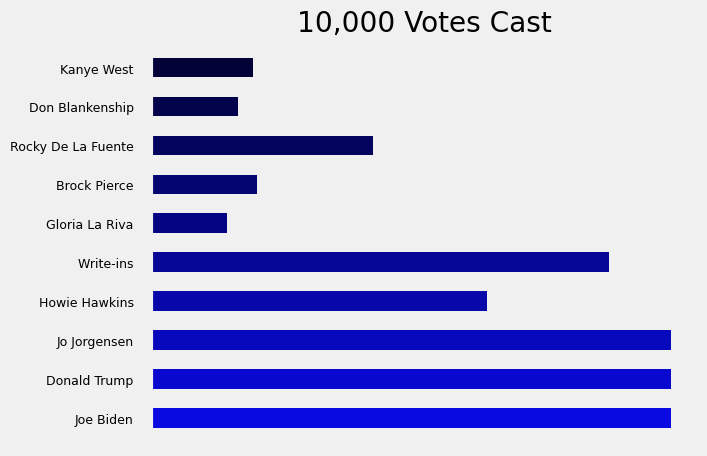

In [8]:
import matplotlib.pyplot as plt
import numpy as np 
import pandas as pd
from collections import Counter

data = pd.read_csv("president_county_candidate.csv") #US 2020 election

candidates = data.filter(["candidate"]).head(10_000).to_dict("records")
names = list()

list(names.append(*i.values()) for i in candidates) #filters only candidate names
x_indexes = np.arange(len(Counter(names).most_common(10)))

plt.style.use('fivethirtyeight')
plt.grid()
plt.tight_layout()
plt.barh(
        pd.Series(Counter(names).keys()).head(10) + "\t".expandtabs(3),
        pd.Series(Counter(names).values()).head(10) ,
        color= [ "#0909e2","#0808cf","#0808bc", "#0707aa", "#060697", "#050584", 
                "#050571", "#04045e", "#03034b", "#020239"] , height= 0.5
        )

plt.xticks([])
plt.yticks(ticks= x_indexes , size = 9 )
plt.title(f"{sum(Counter(names).values()):,} Votes Cast")

plt.show()


6 .15 ***(Intro to Data Science: Dynamic Visualization of Rolling Two Dice)*** Modify your simulation of rolling two dice from Exercise 5.32 to update the bar plot dynamically as you roll the dice. Use the techniques you learned in Section 6.4.2.

In [31]:

# %%capture
%matplotlib notebook

from matplotlib import animation
import matplotlib.pyplot as plt
import numpy as np
import random 
import seaborn as sns
from IPython.display import HTML

def update(frame_number, rolls, faces, frequencies):
    """Configures bar plot contents for each animation frame."""
    
    # roll die and update frequencies
    for i in range(rolls):
        frequencies[random.randrange(1, 7) + random.randrange(1, 7) - 2] += 1
     
    # reconfigure plot for updated die frequencies
    plt.cla()  # clear old contents contents of current Figure
    axes = sns.barplot(y=faces, x=frequencies , orient= 'h',palette='magma',)  # create bars
    axes.set_title(f'Die Frequencies for {sum(frequencies):,} Rolls')
    axes.set(ylabel='Die Value', xlabel='Frequency')  
    axes.set_xlim(0,max( frequencies ) + min(frequencies) * 2)
    axes.set_ylim(-1,max(faces) )

    for bar, frequency in zip(axes.patches, frequencies): # display frequency & percentage to the left of each patch 
    
        text_x =  bar.get_width() + bar.get_height() 
        text_y=  bar.get_y()   
        text = f'{frequency:,}\n{ frequency / sum(frequencies):.3%}'
        axes.text(text_x, text_y, text, 
                fontsize=10, ha='left', va='baseline')
        

number_of_frames = 1000
rolls_per_frame = 6000

sns.set_style('whitegrid') 
figure = plt.figure('Rolling a Six-Sided Die')
figure.tight_layout()      

values = list(range(2, 13))  # Possible sums of two dice  for display on y-axis
frequencies = [0] * 11 #Eleven-element list of die-summing frequencies

# configure and start animation that calls function update
die_animation = animation.FuncAnimation(
                                        figure, update, repeat= False, frames= number_of_frames,
                                        interval=33, fargs=(rolls_per_frame, values, frequencies,), blit=False)

HTML(die_animation.to_jshtml())

<IPython.core.display.Javascript object>

Animation size has reached 20999781 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


6 .16 ***(Intro to Data Science: Dynamic Visualization of the Dice Game of Craps)*** Reimplement your solution to Exercise 5.33 using the techniques you learned in Section 6.4.2 to create a dynamic bar chart showing the wins and losses on the first roll second roll, third roll, etc.

In [13]:
%matplotlib notebook

from matplotlib import animation
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML

 #Initialization Phase
def game_craps() :
    
    """Simulating the dice game Craps."""
        
    def roll_dice():
        """Roll two dice and return their face values as a tuple."""
        import random
        
        die1 = random.randrange(1, 7)
        die2 = random.randrange(1, 7)
        return (die1, die2)  #
    
    die_values = roll_dice()  # first roll
    
    # determine game status and point, based on first roll
    sum_of_dice = sum(die_values)

    if sum_of_dice in (7, 11):  # win
        game_status = 'WON'
        return 1
    elif sum_of_dice in (2, 3, 12):  # lose
        game_status = 'LOST'
        return 0
    else:  # remember point
        game_status = 'CONTINUE'
        my_point = sum_of_dice
        # print('Point is', my_point)

    # continue rolling until player wins or loses
    while game_status == 'CONTINUE':
        die_values = roll_dice()
    
        sum_of_dice = sum(die_values)

        if sum_of_dice == my_point:  # win by making point
            game_status = 'WON'
            # print('Player wins')
            return 1
        
        elif sum_of_dice == 7:  # lose by rolling 7
            game_status = 'LOST'
            # print('Player loses')
            return 0

def update(frame_number, number_of_games, frequencies):
    """Configures bar plot contents for each animation frame."""
    
    rounds =  map(lambda x: [game_craps() for i in range(x) ], number_of_games )  #Play game_craps N-times per round
    frequencies = list( map(lambda x: np.unique(x,return_counts=True)[1], rounds ) )# List with the number of games won and lost of each round
    
    for index, result in enumerate(frequencies):
        won[index] += result[1]
        lost[index] += result[0]
    
    plt.cla()
    x = np.arange(len(number_of_games)) #Number of rounds ,to be used in x-axis and y-axis
    
    width = 0.40

    plt.style.use("fivethirtyeight")
    plt.tight_layout()
    plt.grid()

    games_won = plt.barh(x  - width/2, won, width, color ="#0000ff", label="Games Won\n"f"{won.sum()/ np.sum(won + lost):.2%}")
    games_lost = plt.barh(x + width/2, lost, width, color="#ff0000", label="Games lost\n"f"{lost.sum()/ np.sum(won + lost):.2%}")

    plt.title(f'games won and lost\n in {len(x)} rounds of craps game'.title()) 
    plt.ylabel('Games Played') 
    plt.yticks(ticks= x, labels= [f"{won + lost:,}" for won, lost in zip(won,lost)])
    plt.xticks([])

    plt.bar_label(games_won, padding=3, size= 9)
    plt.bar_label(games_lost, padding=3, size= 9)

    plt.ylim(-1,len(number_of_games) )
    plt.xlim(0, won.min() + lost.max())
    plt.legend()
        

#Processing Phase
figure = plt.figure('Rolling a Craps Game')
number_of_games = np.random.randint(1000, 10_000, 12) # Integers representing the number of times game_craps must be played in each round. 
frequencies = list()# List with the number of games won and lost of each round
won = np.full(len(number_of_games), 0) #Games won in each round
lost = np.full(len(number_of_games), 0)  #Games lost in each round

# configure and start animation that calls function update
die_animation = animation.FuncAnimation(
                                        figure, update, repeat= False, frames= 100,
                                        interval=90, fargs=(number_of_games, frequencies))

HTML(die_animation.to_jshtml())

<IPython.core.display.Javascript object>